In [1]:
# -*- coding: utf-8 -*-
"""
This is a workflow intended to expedite the calculation of flow properties from CenCOOS 2km HF Radar Data
Optimized to run on Eady (eady.caltech.edu)

Please utilize the Dask distributed Client scheduler for best results
Last Updatedd 06/18/2020 Thursday

"""
from IPython.core.display import display, HTML # Widen jupyter notebook
display(HTML("<style>.container { width:100% !important; }</style>"))

In [6]:
# Setup Distributed Client
autostart = True
if autostart:
    pass # just let it use the dask lab extension cluster
else:
    from dask.diagnostics import ProgressBar
    from dask.distributed import Client
    from dask.distributed import LocalCluster
    # client = Client('localhost:8787') # Connect to old dashboard?
    try:
        client = Client('tcp://localhost:8786', timeout='2s')
    except OSError:
        cluster = LocalCluster(scheduler_port=8786)
        client = Client(cluster)
client

Client Scheduler: tcp://127.0.0.1:42986 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 6 Cores: 24 Memory: 134.93 GB


In [7]:
#%% Setup Packages
import xarray as xr
from xarray import open_mfdataset
import dask
import dask.array as da
import netCDF4 as netcdf
import numpy as np
import datetime
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import cartopy.crs as ccrs
import metpy.calc as mpcalc
from metpy.units import units
from importlib import reload

import gc
_ = gc.collect()

import sys
import os

sys.path.insert(1,r"/export/home1/jbenjami/Research_Thompson/Python/personal/")
print(sys.path)
import personal

import personal.math as pm
import personal.data_structures
import personal.date_operations
import personal.SMODE
import personal.plots

#%% Plot setup
dpi = 100
from matplotlib.axes import Axes
from cartopy.mpl.geoaxes import GeoAxes
GeoAxes._pcolormesh_patched = Axes.pcolormesh

['/export/home1/jbenjami/Research_Thompson/Python', '/export/home1/jbenjami/Research_Thompson/Python/personal/', '/export/home1/jbenjami/Research_Thompson/Python/personal/', '/export/home1/jbenjami/anaconda3/lib/python37.zip', '/export/home1/jbenjami/anaconda3/lib/python3.7', '/export/home1/jbenjami/anaconda3/lib/python3.7/lib-dynload', '', '/export/home1/jbenjami/anaconda3/lib/python3.7/site-packages', '/export/home1/jbenjami/anaconda3/lib/python3.7/site-packages/IPython/extensions', '/export/home1/jbenjami/.ipython']


In [8]:
#%% Load Retrieved Data
#file_path = os.path.abspath(os.path.dirname(__file__)) # works locally but not in notebook
file_path = os.path.abspath(os.path.dirname(''))
data_relpath_2km = "../Data/HF_Radar/2km/"
data_source      = os.path.normpath(os.path.join(file_path, data_relpath_2km))

In [14]:
#xr_data = xr.open_dataset(data_source, decode_times=True) # decoding times seems to work
#xr_data = xr.open_dataset(data_source, decode_times=True,chunks={}) # decoding times seems to work, dask chunks for speed
#xr_data = xr.open_dataset(data_source, decode_times=True,chunks={'time':1000}) # decoding times seems to work, dask chunks for spee
xr_data = xr.open_mfdataset(data_source+'/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
#vor_data  = xr.open_mfdataset(data_source+'/vorticity/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'lon':200,'lat':200,'time':1}) # decoding times seems to work, dask chunks for speed
lat              = xr_data['lat']
lon              = xr_data['lon']
time             = xr_data['time']
xr_data

<xarray.Dataset>
Dimensions:                (lat: 1099, lon: 700, nv: 2, time: 75588, time_1: 1)
Coordinates:
  * lat                    (lat) float32 30.25 30.26798 ... 49.97406 49.99204
  * lon                    (lon) float32 -130.36 -130.33917 ... -115.805565
  * time                   (time) datetime64[ns] 2012-01-01 ... 2020-09-30T17...
    time_run               (time) datetime64[ns] dask.array<chunksize=(24,), meta=np.ndarray>
Dimensions without coordinates: nv, time_1
Data variables:
    time_bnds              (time_1, nv) int32 dask.array<chunksize=(1, 2), meta=np.ndarray>
    depth_bnds             (nv) float32 dask.array<chunksize=(2,), meta=np.ndarray>
    wgs84                  int8 ...
    processing_parameters  int8 ...
    radial_metadata        int8 ...
    depth                  float32 ...
    time_offset            (time) datetime64[ns] dask.array<chunksize=(24,), meta=np.ndarray>
    u                      (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
    v                      (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
    dopx                   (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
    dopy                   (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
    hdop                   (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
    number_of_sites        (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
    number_of_radials      (time, lat, lon) float32 dask.array<chunksize=(24, 1099, 700), meta=np.ndarray>
Attributes:
    Conventions:               CF-1.4, ACDD-1.3
    id:                        202007072100siohfruwlsrtvuswc2km
    date_created:              2020-07-07T23:20:25Z
    source:                    surface ocean velocity field from hf-radar
    program:                   Integrated Ocean Observing System (IOOS)
    title:                     Near-Real Time Surface Ocean Velocity, U.S. We...
    summary:                   Surface ocean velocities estimated from HF-Rad...
    instrument:                Earth Remote Sensing Instruments, Active Remot...
    keywords:                  Earth Science, Oceans, Sea Surface, Coastal Pr...
    geospatial_lat_min:        30.25
    geospatial_lat_max:        49.99204
    geospatial_lon_min:        -130.36
    geospatial_lon_max:        -115.805565
    processing_level:          Near real-time dataset with automated data acq...
    history:                   2020-07-07T22:20:40Z hfrnet rtvMergeData: Savi...
    references:                Terrill, E. et al., 2006. Data Management and ...
    institution:               Coastal Observing Research and Development Cen...
    creator_type:              group
    creator_name:              HFRNet Administrators
    creator_email:             hfrnet.administrators@sio.ucsd.edu
    creator_url:               http://cordc.ucsd.edu/projects/mapping/
    naming_authority:          edu.ucsd.cordc
    standard_name_vocabulary:  CF Standard Name Table, Version 51
    keywords_vocabulary:       Global Change Master Directory (GCMD) Keywords...
    instrument_vocabulary:     Global Change Master Directory (GCMD) Keywords...
    format_version:            1.1.00
    product_version:           2.0.00
    _CoordSysBuilder:          ucar.nc2.dataset.conv.CF1Convention
    cdm_data_type:             GRID
    featureType:               GRID
    location:                  Proto fmrc:HFRADAR_US_West_Coast_2km_Resolutio...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
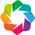

dropping extraneous coords ['time_run']
trying to get projection from data...
...failed, continuing with no projection
:Dataset   [lat,lon,time,variable]   (stack-d6b699c6faf003898813acbd319c565e)
Rendering with coastlines


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [15]:
reload(personal.plots)
groups = ('[u, v]', '[number_of_sites, number_of_radials]','[dopx, dopy, hdop]')
plot_data = {groups[0]:xr_data[['u','v']].to_array().to_dataset(), groups[1]:xr_data[['number_of_sites', 'number_of_radials']].to_array().to_dataset(), groups[2]:xr_data[['dopx','dopy','hdop']].to_array().to_dataset()}
cmap_0 = LinearSegmentedColormap.from_list("mycmap", [[1,1,1],[0,0,.5],[0,.5,0],'yellow',[1,0,0],'pink'],N=250)
personal.plots.data_map_viewer(plot_data, projection=None,clim={groups[0]:(-.3,.3),groups[1]:(0,10),groups[2]:(0,1)},  cmap = {groups[0]:None,groups[1]:cmap_0,groups[2]:cmap_0},  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [16]:
#%% Clip data to smode boundaries 
reload(personal.SMODE)
smode_data = personal.SMODE.select_SMODE_region(xr_data,rechunk=False) #.metpy.parse_cf() don't parse here (only for mpcalc) bc can't save parsed? # rechunk saves a bunch of steps
# smode_data = smode_data.chunk({'time':24,'lat':len(smode_data['lat']),'lon':len(smode_data['lon'])}) # chunked this way for speed since we are now just saving calcs to disk....
smode_data = personal.data_structures.nanclip(smode_data,axis=0, return_slices=False,representative_variable='u') # close crop data to smallest box for smode box given above (note, is slow)
smode_data_mp = smode_data.metpy.parse_cf()
smode_data

<xarray.Dataset>
Dimensions:                (lat: 256, lon: 166, nv: 2, time: 75588, time_1: 1)
Coordinates:
  * lat                    (lat) float32 34.00782 34.0258 ... 38.57474 38.59272
  * lon                    (lon) float32 -123.967705 -123.946884 ... -120.53211
  * time                   (time) datetime64[ns] 2012-01-01 ... 2020-09-30T17...
    time_run               (time) datetime64[ns] dask.array<chunksize=(24,), meta=np.ndarray>
Dimensions without coordinates: nv, time_1
Data variables:
    time_bnds              (time_1, nv) int32 dask.array<chunksize=(1, 2), meta=np.ndarray>
    depth_bnds             (nv) float32 dask.array<chunksize=(2,), meta=np.ndarray>
    wgs84                  int8 ...
    processing_parameters  int8 ...
    radial_metadata        int8 ...
    depth                  float32 ...
    time_offset            (time) datetime64[ns] dask.array<chunksize=(24,), meta=np.ndarray>
    u                      (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
    v                      (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
    dopx                   (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
    dopy                   (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
    hdop                   (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
    number_of_sites        (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
    number_of_radials      (time, lat, lon) float32 dask.array<chunksize=(24, 256, 166), meta=np.ndarray>
Attributes:
    Conventions:               CF-1.4, ACDD-1.3
    id:                        202007072100siohfruwlsrtvuswc2km
    date_created:              2020-07-07T23:20:25Z
    source:                    surface ocean velocity field from hf-radar
    program:                   Integrated Ocean Observing System (IOOS)
    title:                     Near-Real Time Surface Ocean Velocity, U.S. We...
    summary:                   Surface ocean velocities estimated from HF-Rad...
    instrument:                Earth Remote Sensing Instruments, Active Remot...
    keywords:                  Earth Science, Oceans, Sea Surface, Coastal Pr...
    geospatial_lat_min:        30.25
    geospatial_lat_max:        49.99204
    geospatial_lon_min:        -130.36
    geospatial_lon_max:        -115.805565
    processing_level:          Near real-time dataset with automated data acq...
    history:                   2020-07-07T22:20:40Z hfrnet rtvMergeData: Savi...
    references:                Terrill, E. et al., 2006. Data Management and ...
    institution:               Coastal Observing Research and Development Cen...
    creator_type:              group
    creator_name:              HFRNet Administrators
    creator_email:             hfrnet.administrators@sio.ucsd.edu
    creator_url:               http://cordc.ucsd.edu/projects/mapping/
    naming_authority:          edu.ucsd.cordc
    standard_name_vocabulary:  CF Standard Name Table, Version 51
    keywords_vocabulary:       Global Change Master Directory (GCMD) Keywords...
    instrument_vocabulary:     Global Change Master Directory (GCMD) Keywords...
    format_version:            1.1.00
    product_version:           2.0.00
    _CoordSysBuilder:          ucar.nc2.dataset.conv.CF1Convention
    cdm_data_type:             GRID
    featureType:               GRID
    location:                  Proto fmrc:HFRADAR_US_West_Coast_2km_Resolutio...

In [19]:
# Save velocity (we should do most of the analysis with smoothed data, smooth in u,v first because derivative properties may not have the same positive/negative ranges/distributions
outpath  = data_relpath_2km + '/processed/smode_region/velocity/'
years    = smode_data.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = smode_data[['u','v']].isel(time=valid)
    personal.data_structures.xr_save_by_date_strtfmt(out_yr.compute(),filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Velocity',return_filenames_datasets=True) # much faster to compute and roll on

In [20]:
# Load velocity from regular location
file_path = os.path.abspath(os.path.dirname(''))
data_relpath_2km = "../Data/HF_Radar/2km/"
data_source      = os.path.normpath(os.path.join(file_path, data_relpath_2km))
smode_data = xr.open_mfdataset(data_source+'/processed/smode_region/velocity/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
smode_data_mp = smode_data.metpy.parse_cf()

Could not find variable corresponding to the value of grid_mapping: wgs84
Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable
Could not find variable corresponding to the value of grid_mapping: wgs84
Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
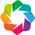

dropping extraneous coords ['time_run']
trying to get projection from data...
...failed, continuing with no projection
:Dataset   [lat,lon,time,variable]   (stack-2848f686cd74b5d24ab718afae838b51)


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [22]:
reload(personal.plots)
plot_data =smode_data.to_array().to_dataset() # stack to get better variable browser in menu on right
personal.plots.data_map_viewer(plot_data, projection=None,clim=(-.3,.3),  cmap = None,  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [23]:
# Save smoothed velocity (we should do most of the analysis with smoothed data, smooth in u,v first because derivative properties may not have the same positive/negative ranges/distributions
# smode_data = xr.open_mfdataset(data_source + '/processed/smode_region/velocity/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
time_smoothing = 24 # smoothed 24 hours in case of gravity waves
outpath  = data_relpath_2km + '/processed/smode_region/smoothed/velocity/'
out      = smode_data[['u','v']]; # can only roll number values so we select u,v (loses attributes in the process but)
out      = out.chunk({'time':48}).rolling(time=time_smoothing,center=True,min_periods=1).mean() 
years    = out.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = out.isel(time=valid)
    personal.data_structures.xr_save_by_date_strtfmt(out_yr.compute(),filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Velocity',return_filenames_datasets=True) # much faster to compute and roll on
# personal.data_structures.xr_save_by_date_strtfmt(out ,filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Velocity',return_filenames_datasets=True) # rashes sometimes

In [28]:
# Load smoothed data from smoothed location
file_path = os.path.abspath(os.path.dirname(''))
data_relpath_2km = "../Data/HF_Radar/2km/"
data_source      = os.path.normpath(os.path.join(file_path, data_relpath_2km))
smode_data_smoothed = xr.open_mfdataset(data_source+'/processed/smode_region/smoothed/velocity/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
smode_data_smoothed_mp = smode_data_smoothed.metpy.parse_cf()

Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable
Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
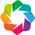

dropping extraneous coords ['time_run']
trying to get projection from data...
...failed, continuing with no projection
:Dataset   [lat,lon,time,variable]   (stack-0129d9810900d06008f6c3af279ac7de)


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [25]:
reload(personal.plots)
plot_data =smode_data_smoothed.to_array().to_dataset() # stack to get better variable browser in menu on right
personal.plots.data_map_viewer(plot_data, projection=None,clim=(-.3,.3),  cmap = None,  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [5]:
#%% Calculate Vorticity pm.curl (deprecated)
dims = {'t':0,'y':1,'x':2}
dx, dy = mpcalc.grid_deltas_from_dataarray(smode_data_mp['u'])
# dy     = da.from_array(dy,name=False)
# dx     = da.from_array(dx,name=False)

y      = pm.dq_to_q(np.array(dy),dims['y'])
y      = da.from_array(y)
y      = np.repeat(y,smode_data['u'].shape[dims['t']],dims['t']) #expand to full arrays
x      = pm.dq_to_q(np.array(dx),dims['x'])
x      = da.from_array(x)
x      = np.repeat(x,smode_data['u'].shape[dims['t']],dims['t'])
# can't recall which is right
#vor    = pm.curl([smode_data['v'[0].values,smode_data['u'[0].values],pm.dq_to_q(np.array(dy[0]),0),pm.dq_to_q(np.array(dx[0]),1), method='npgradient',periodic=False,dims={'y':0,'x':1})
vor    = pm.curl({0:smode_data['u'].values, 1:smode_data['v'].values}, dims_to_space_dims={0:2,1:1}, coord_arrays={0:x,1:y}, method='npgradient',periodic=False); vor = vor[2] #the z component
# e.g. dims_to_space_dims={0:2,1:1} tells you spatial dimension  0 is dim 2 in the array, spatial dimension 1 is dim 1 (this is because x is 2, y is 1, and t is 0 in our arrays ) coords={0:x,1:y} tells you spatial dimension  1 is given by array x,   spatial dimension 2 is given by the array y

{0: array([[[        nan,         nan,         nan, ...,  0.002     ,
         -0.14999999,  0.08499999],
        [        nan,         nan,         nan, ...,         nan,
                 nan,  0.06222222],
        [        nan,         nan,         nan, ...,         nan,
                 nan,  0.05599999],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[        nan,         nan,         nan, ...,  0.002     ,
         -0.14999999,  0.08499999],
        [        nan,         nan,         nan, ...,         nan,
                 nan,  0.053     ],
        [        nan,         nan,         nan, ...,         nan,
                 nan,  0.05181818],
        ...,
        [        nan,         nan,         nan, ..

/export/home1/jbenjami/anaconda3/lib/python3.7/site-packages/dask/array/core.py:1395: FutureWarning: The `numpy.ndim` function is not implemented by Dask array. You may want to use the da.map_blocks function or something similar to silence this warning. Your code may stop working in a future release.
  FutureWarning,


KilledWorker: ("('repeat-547557eb133a6a153a8c6acb508fee22', 0, 0, 0)", <Worker 'tcp://127.0.0.1:38807', name: 0, memory: 0, processing: 1>)

In [50]:
#%% Calculate vorticity mpcalc w/ apply_ufunc for distributed (deprecated)
dx, dy = mpcalc.grid_deltas_from_dataarray(smode_data_mp['u'])
def F(u,v):
    #import metpy.calc as mpcalc
    from metpy.units import units # can't pickle units registry, so gotta load on the inside
    return mpcalc.vorticity(u*units('m/s'),v*units('m/s'),dx[0],dy[0], dim_order = 'yx')

# This function is gonna load the whole chunk when dask parallelized gets called (I think, should check)
vor = xr.apply_ufunc(
    F,
    smode_data_mp['u'],
    smode_data_mp['v'],
    input_core_dims = [["lat","lon"],["lat","lon"]],    # dims we mut have
    output_core_dims = [["lat","lon"]],                 # dims output must have
    exclude_dims = set(()),                             # dims to exclude from broadcasting and alignment
    vectorize = True,                                   # 
    dask = "parallelized",                              # ’forbidden’ (default): raise an error if a dask array is encountered. ’allowed’: pass dask arrays directly on to func. ’parallelized’: automatically parallelize func if any of the inputs are a dask array. If used, the output_dtypes argument must also be provided. Multiple output arguments are not yet supported.
    output_dtypes=[smode_data_mp['u'].dtype]
    )

In [8]:
#%% Calculate vorticity pm.curl w/ apply_ufunc for distributed (deprecated)

dims ={'t':0,'y':1,'x':2}
dx, dy = mpcalc.grid_deltas_from_dataarray(smode_data_mp['u'])
y      = pm.dq_to_q(np.array(dy),dims['y'])
y      = np.squeeze(y)
#y      = np.repeat(y,smode_data['u'.shape[dims['t']],dims['t']) #expand to full arrays
x      = pm.dq_to_q(np.array(dx),dims['x'])
x      = np.squeeze(x)

smode_data_mp = smode_data.metpy.parse_cf().isel(time=np.arange(10)) #.compute()

new_coords = {'time':smode_data_mp.coords['time'], 'lon':smode_data_mp.coords['lon'], 'lat':smode_data_mp.coords['lat']}
new_coords = {key:new_coords[key] for key in new_coords.keys() if key != 'time'}
new_dims   = smode_data_mp['u'].dims
new_dims   = new_dims[1:]
m = 1; # shift bc slicing moves you down a dimension;
# e.g. dims_to_space_dims={0:2,1:1} tells you spatial dimension  0 is dim 2 in the array, spatial dimension 1 is dim 1 (this is because x is 2, y is 1, and t is 0 in our arrays ) coords={0:x,1:y} tells you spatial dimension  1 is given by array x,   spatial dimension 2 is given by the array y
def F(u,v,x=x,y=y):
#     from metpy.units import units # can't pickle units registry, so gotta load on the inside
    print('herewego')
    vor = pm.curl({0:u, 1:v}, dims_to_space_dims={0:2-1,1:1-1}, coord_arrays={0:x,1:y}, method='npgradient',periodic=False)
    print(vor)
    vor = vor[2] #the z component
    return vor
#     return xr.DataArray(vor,coords=new_coords,dims=new_dims)

vor = xr.apply_ufunc(
    F,
    smode_data_mp['u'],
    smode_data_mp['v'],
    input_core_dims = [["lat","lon"],["lat","lon"]],    # dims we mut have
    output_core_dims = [["lat","lon"]],                 # dims output must have
    exclude_dims = set(()),                             # dims to exclude from broadcasting and alignment
    vectorize = True,                                   # 
    keep_attrs= False,
    dask = "parallelized",                                   # ’forbidden’ (default): raise an error if a dask array is encountered. ’allowed’: pass dask arrays directly on to func. ’parallelized’: automatically parallelize func if any of the inputs are a dask array. If used, the output_dtypes argument must also be provided. Multiple output arguments are not yet supported.
    output_dtypes=[smode_data_mp['u'].dtype]
    )

Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable
Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable


In [38]:
#%% Calculate Jacobian pm.Jac w/ apply_ufunc for distributed (broken with update, deprecated)
dims ={'t':0,'y':1,'x':2}
dx, dy = mpcalc.grid_deltas_from_dataarray(smode_data_mp['u'])
y      = pm.dq_to_q(np.array(dy),dims['y'])
y      = np.squeeze(y)
#y      = np.repeat(y,smode_data['u'.shape[dims['t']],dims['t']) #expand to full arrays
x      = pm.dq_to_q(np.array(dx),dims['x'])
x      = np.squeeze(x)
#x      = np.repeat(x,smode_data_mp['u'].shape[dims['t']],dims['t'])

#arr = {1:smode_data_mp['u'].values, 2:smode_data_mp['v'].values}
#Jac = pm.Jacobian(arr,deriv_dims=[1,2],coord_arrays={1:x,2:y},method='npgradient',periodic=False)

new_coords = {'time':smode_data['u'].coords['time'], 'lon':smode_data['u'].coords['lon'], 'lat':smode_data['u'].coords['lat'], 'deriv': ['dudx','dudy','dvdx','dvdy']}
new_coords = {key:new_coords[key] for key in new_coords.keys() if key != 'time'}
new_dims   = smode_data['u'].dims + ('deriv',)
new_dims   = new_dims[1:]


# switch to multiple outputs??
def F(u,v):
    m=1 # a shift since the parallelized slices lose a dimension
    out = pm.Jacobian({1:u,2:v},deriv_dims=[1-m,2-m],coord_arrays={1-m:y,2-m:x},method='npgradient',periodic=False) # note /dy is going first, then /dx from deriv_dims/coord_arrays, but du/ first then dy/ from {}
#     out = np.stack([out[1][1-m],out[1][2-m],out[2][1-m],out[2][2-m]],axis=3-m) # stack along new axis, from numpy index order [[1,2],[3,4]] = [[du/dy, du/dx], [dv/dy, dv/dx]] (old, deprecated, incorrect)
    out = np.stack([out[1][2-m],out[1][1-m],out[2][2-m],out[2][1-m]],axis=3-m) # stack along new axis, from numpy index order [[1,2],[3,4]] = [[du/dx, du/dy], [dv/dx, dv/dy]]
    out = xr.DataArray(out,coords=new_coords,dims=new_dims)
    out = out.where(np.abs(out) != np.inf) # replace inf w/ nan
    #out = tuple(xr.DataArray(x,u.coords,u.dims,u.attrs) for x in  out) # can't do parallelized
    return out

Jac = xr.apply_ufunc(
    F,
    smode_data_mp['u'],
    smode_data_mp['v'],
    input_core_dims = [["lat","lon"],["lat","lon"]],    # dims we mut have
    output_core_dims = [["lat","lon",'deriv']],         # dims output must have
    exclude_dims = set(()),                             # dims to exclude from broadcasting and alignment
    vectorize = True,                                   # 
    keep_attrs = False,
    dask = "parallelized",                              # ’forbidden’ (default): raise an error if a dask array is encountered. ’allowed’: pass dask arrays directly on to func. ’parallelized’: automatically parallelize func if any of the inputs are a dask array. If used, the output_dtypes argument must also be provided. Multiple output arguments are not yet supported.
    output_dtypes=[smode_data_mp['u'].dtype],
#     output_sizes={'deriv':4}
    dask_gufunc_kwargs = {'output_sizes':{'deriv':4}}
    )
Jac['deriv'] = new_coords['deriv']

/export/home1/jbenjami/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.


In [30]:
# Calculate Gradients
def calc_gradients(data,time_chunk=24, dims={'t':0,'y':1,'x':2},parallel_args = {'n_jobs':5,'require':'sharedmem'},verbose=True,progres_bar=True,mmap_input=False,mmap_output=False,parallelize=True):
    dx, dy = mpcalc.grid_deltas_from_dataarray(data['u'])
    y      = pm.dq_to_q(np.array(dy),dims['y'])
    x      = pm.dq_to_q(np.array(dx),dims['x'])
    t      = np.arange(len(data.time))

    def F(inds,data=data,x=x,y=y,dims=dims):
        u = data['u'][inds].values
        v = data['v'][inds].values
        m = 0 # no shift since  no parllelization and so no  slices lose a dimension
        out = pm.Jacobian({1:u,2:v},deriv_dims=[1-m,2-m],coord_arrays={1-m:y,2-m:x},method='npgradient',periodic=False) # note /dy is going first, then /dx from deriv_dims/coord_arrays, but du/ first then dy/ from {}
        # out = np.stack([out[1][1-m],out[1][2-m],out[2][1-m],out[2][2-m]],axis=3-m) # stack along new axis, from numpy index order [[1,2],[3,4]] = [[du/dy, du/dx], [dv/dy, dv/dx]] (old, deprecated, incorrect)
        out = np.stack([out[1][2-m],out[1][1-m],out[2][2-m],out[2][1-m]],axis=3-m) # stack along new axis, from numpy index order [[1,2],[3,4]] = [[du/dx, du/dy], [dv/dx, dv/dy]]
        return out
    
    Jac = personal.data_structures.apply_in_chunks(  F,
                                                     t,
                                                     output_shape       = data['u'].shape + (4,),
                                                     input_chunk_sizes  = {0:time_chunk},
                                                     output_chunk_sizes = {0:time_chunk}, # defaults to 1 for others
                                                     parallelize        = parallelize,
                                                     parallel_args      = parallel_args,
                                                     progress_bar       = progres_bar,
                                                     verbose            = verbose,
                                                     mmap_input         = mmap_input,
                                                     mmap_output        = mmap_output,
                                                     fcn_kwargs         = {'data': data.compute()})

    new_coords = {'time':data['u'].coords['time'], 'lon':data['u'].coords['lon'], 'lat':data['u'].coords['lat'], 'deriv': ['dudx','dudy','dvdx','dvdy']}
    new_dims   = data['u'].dims + ('deriv',)
    Jac = xr.DataArray(Jac,coords=new_coords,dims=new_dims).astype('float32')
    Jac = Jac.where(np.abs(Jac) != np.inf) # replace inf w/ nan
    return Jac.to_dataset(name='gradients')

In [27]:
# Save Gradients to Disk
reload(personal.data_structures)
reload(personal.math)
data=smode_data_mp
tchunk = 24*10
njobs = 20
outpath  = data_relpath_2km + '/processed/smode_region/gradients/'
years    = smode_data_mp.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = smode_data_mp.isel(time=valid)
    Jac = calc_gradients(out_yr,verbose=True,time_chunk=tchunk, parallel_args={'n_jobs':njobs                       ,'require':'sharedmem'},mmap_input=False,mmap_output=True)
    # Jac = calc_gradients(data,verbose=True,time_chunk=tchunk, parallel_args={'n_jobs':njobs,'max_nbytes':int(1e9) }                      ,mmap_input=False,mmap_output=True) # slow
    Jac['vorticity']          = Jac['gradients'].sel(deriv='dvdx') - Jac['gradients'].sel(deriv='dudy')  # dv/dx - du/dy
    Jac['divergence']         = Jac['gradients'].sel(deriv='dudx') + Jac['gradients'].sel(deriv='dvdy')  # du/dx + dv/dy
    Jac['shear_strain_rate']  = Jac['gradients'].sel(deriv='dvdx') + Jac['gradients'].sel(deriv='dudy')  # dv/dx + du/dy
    Jac['normal_strain_rate'] = Jac['gradients'].sel(deriv='dudx') - Jac['gradients'].sel(deriv='dvdy')  # du/dx - dv/dy
    Jac['strain_rate']        = (Jac['normal_strain_rate']**2 + Jac['shear_strain_rate']**2)**(1./2)

    personal.data_structures.xr_save_by_date_strtfmt(Jac,filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Gradients',return_filenames_datasets=True) # much faster to compute and roll on
    _=gc.collect()

running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 33 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 28 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


In [31]:
# Save Smooothed Gradients to Disk
reload(personal.data_structures)
reload(personal.math)
data=smode_data_smoothed_mp
tchunk = 24*10
njobs = 20
outpath  = data_relpath_2km + '/processed/smode_region/smoothed/gradients/'
years    = smode_data_smoothed_mp.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = smode_data_smoothed_mp.isel(time=valid)
    Jac = calc_gradients(out_yr,verbose=True,time_chunk=tchunk, parallel_args={'n_jobs':njobs                       ,'require':'sharedmem'},mmap_input=False,mmap_output=True)
    # Jac = calc_gradients(data,verbose=True,time_chunk=tchunk, parallel_args={'n_jobs':njobs,'max_nbytes':int(1e9) }                      ,mmap_input=False,mmap_output=True) # slow
    Jac['vorticity']          = Jac['gradients'].sel(deriv='dvdx') - Jac['gradients'].sel(deriv='dudy')  # dv/dx - du/dy
    Jac['divergence']         = Jac['gradients'].sel(deriv='dudx') + Jac['gradients'].sel(deriv='dvdy')  # du/dx + dv/dy
    Jac['shear_strain_rate']  = Jac['gradients'].sel(deriv='dvdx') + Jac['gradients'].sel(deriv='dudy')  # dv/dx + du/dy
    Jac['normal_strain_rate'] = Jac['gradients'].sel(deriv='dudx') - Jac['gradients'].sel(deriv='dvdy')  # du/dx - dv/dy
    Jac['strain_rate']        = (Jac['normal_strain_rate']**2 + Jac['shear_strain_rate']**2)**(1./2)
    personal.data_structures.xr_save_by_date_strtfmt(Jac,filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Gradients',return_filenames_datasets=True) # much faster to compute and roll on
    _=gc.collect()

running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 33 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 37 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


running in parallel with 28 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


In [4]:
# Load regular data from regular location
file_path        = os.path.abspath(os.path.dirname(''))
data_relpath_2km = "../Data/HF_Radar/2km/"
data_source      = os.path.normpath(os.path.join(file_path, data_relpath_2km))
gradients        = xr.open_mfdataset(data_source+'/processed/smode_region/gradients/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed

# gradients['vorticity']          = gradients['gradients'].sel(deriv='dvdx') + gradients['gradients'].sel(deriv='dudy')  # dv/dx - du/dy
# gradients['divergence']         = gradients['gradients'].sel(deriv='dudx') + gradients['gradients'].sel(deriv='dvdy')  # du/dx + dv/dy
# gradients['shear_strain_rate']  = gradients['gradients'].sel(deriv='dvdx') + gradients['gradients'].sel(deriv='dvdy')  # dv/dx + du/dy
# gradients['normal_strain_rate'] = gradients['gradients'].sel(deriv='dudx') - gradients['gradients'].sel(deriv='dvdy')  # du/dx - dv/dy
# gradients['strain_rate']        = (gradients['normal_strain_rate']**2 + gradients['shear_strain_rate']**2)**(1./2)

gradients

,Array,Chunk
Bytes,51.40 GB,16.32 MB
Shape,"(75588, 256, 166, 4)","(24, 256, 166, 4)"
Count,9462 Tasks,3154 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,12.85 GB,4.08 MB
Shape,"(75588, 256, 166)","(24, 256, 166)"
Count,9462 Tasks,3154 Chunks
Type,float32,numpy.ndarray


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
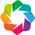

trying to get projection from data...
...failed, continuing with no projection
:Dataset   [deriv,lat,lon,time,variable]   (stack-800b8f4a82f61fb679a862aacd14057d)


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [5]:
reload(personal.plots)
groups = ('derivatives', 'properties' ,'total strain rate')
plot_data = {groups[0]:gradients[['gradients']].to_array().to_dataset(), groups[1]:gradients[['vorticity','divergence','shear_strain_rate','normal_strain_rate']].to_array().to_dataset(), groups[2]:gradients[['strain_rate']].to_array().to_dataset()}

cmap_0 = LinearSegmentedColormap.from_list("mycmap", [[1,1,1],[0,0,.5],[0,.5,0],'yellow',[1,0,0],'pink'],N=250)
personal.plots.data_map_viewer(plot_data, projection=None,clim={groups[0]:tuple(np.array((-5,5))*10**-5),groups[1]:tuple(np.array((-1,1))*10**-4),groups[2]:tuple(np.array((0,1))*10**-4)},  cmap = {groups[0]:None,groups[1]:None,groups[2]:cmap_0},  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [86]:
# Load smoothed data from smoothed location
file_path          = os.path.abspath(os.path.dirname(''))
data_relpath_2km   = "../Data/HF_Radar/2km/"
data_source        = os.path.normpath(os.path.join(file_path, data_relpath_2km))
gradients_smoothed = xr.open_mfdataset(data_source+'/processed/smode_region/smoothed/gradients/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed

gradients_smoothed['vorticity']          = gradients_smoothed['gradients'].sel(deriv='dvdx') + gradients_smoothed['gradients'].sel(deriv='dudy')  # dv/dx - du/dy
gradients_smoothed['divergence']         = gradients_smoothed['gradients'].sel(deriv='dudx') + gradients_smoothed['gradients'].sel(deriv='dvdy')  # du/dx + dv/dy
gradients_smoothed['shear_strain_rate']  = gradients_smoothed['gradients'].sel(deriv='dvdx') + gradients_smoothed['gradients'].sel(deriv='dvdy')  # dv/dx + du/dy
gradients_smoothed['normal_strain_rate'] = gradients_smoothed['gradients'].sel(deriv='dudx') - gradients_smoothed['gradients'].sel(deriv='dvdy')  # du/dx - dv/dy
gradients_smoothed['strain_rate']        = (gradients_smoothed['normal_strain_rate']**2 + gradients_smoothed['shear_strain_rate']**2)**(1./2)

gradients_smoothed

,Array,Chunk
Bytes,51.40 GB,16.32 MB
Shape,"(75588, 256, 166, 4)","(24, 256, 166, 4)"
Count,9462 Tasks,3154 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,12.85 GB,4.08 MB
Shape,"(75588, 256, 166)","(24, 256, 166)"
Count,18924 Tasks,3154 Chunks
Type,float32,numpy.ndarray


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
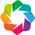

trying to get projection from data...
...failed, continuing with no projection
:Dataset   [deriv,lat,lon,time,variable]   (stack-0606d38085346eff62907a8329829fb3)


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [87]:
reload(personal.plots)
groups = ('derivatives', 'properties' ,'total strain rate')
plot_data = {groups[0]:gradients_smoothed[['gradients']].to_array().to_dataset(), groups[1]:gradients_smoothed[['vorticity','divergence','shear_strain_rate','normal_strain_rate']].to_array().to_dataset(), groups[2]:gradients_smoothed[['strain_rate']].to_array().to_dataset()}

cmap_0 = LinearSegmentedColormap.from_list("mycmap", [[1,1,1],[0,0,.5],[0,.5,0],'yellow',[1,0,0],'pink'],N=250)
personal.plots.data_map_viewer(plot_data, projection=None,clim={groups[0]:tuple(np.array((-5,5))*10**-5),groups[1]:tuple(np.array((-1,1))*10**-4),groups[2]:tuple(np.array((0,1))*10**-4)},  cmap = {groups[0]:None,groups[1]:None,groups[2]:cmap_0},  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [113]:
# Calculate speed/KE per unit mass

energy          = smode_data_mp[['u','v']]
total           = energy['u']**2 + energy['v']**2
energy['speed'] = total**(1./2)
energy['KE']    = (1./2) * total
energy          = energy.drop(['u','v','crs'])

outpath  = data_relpath_2km + '/processed/smode_region/kinetic_energy/'
years    = energy.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = energy.isel(time=valid)
    personal.data_structures.xr_save_by_date_strtfmt(out_yr.compute(),filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Kinetic_Energy',return_filenames_datasets=True) # much faster to compute and roll on

In [12]:
# Kinetic Energy normal (Calculate speed/KE per unit mass)
energy          = smode_data_mp[['u','v']]

# do EKE
# t_year = 24 * 365
# lt = len(energy['time'])

# Avoided doing subtracting each year's mean or something like that etc since it could lead to discontinuities in EKE etc. implement rolling mean optimitzed with tracking (see comments in personal.data_structures.rolling_groups) then come back to this
# or switch to zarr and use https://github.com/pangeo-data/rechunker , https://rechunker.readthedocs.io/en/latest/
baseline_methods = { None             : (lambda x: x,
                                         lambda x: 0),
                    #'mean year'       : (lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')), # works but seems to fail on saving.... (maybe zarr better)
                    #                     lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')).mean(dim='time') ), # groupby time to make annual cycle (worse than rolling but oh well...)    
                    'all'             : (lambda x: x ,
                                         lambda x: x.mean(dim="time").compute() ),
                    # 'rolling month'   : lambda x: x - do_rolling(x, window = min(t_year//12, lt), parallel_args={'n_jobs':200    ,'require':'sharedmem'} ), # add these back when rolling imiproves
                    # 'rolling season'  : lambda x: x - do_rolling(x, window = min(t_year//4 , lt), parallel_args={'n_jobs':200//4 ,'require':'sharedmem'} ), #
                    # 'rolling year'    : lambda x: x - x - do_rolling(x, window = min(t_year    , lt), parallel_args={'n_jobs':200//12,'require':'sharedmem'} ), #
                   }

u, v = energy['u'], energy['v']

baselines = list(baseline_methods.keys())
out       = dict.fromkeys(baselines)
for baseline in baselines: out[baseline] =  {}

for i,(baseline,method) in enumerate(baseline_methods.items()):
    print('processing baseline : ' + str(baseline))
    out[baseline]['u_p'] = baseline_methods[baseline][0](u) - baseline_methods[baseline][1](u)
    out[baseline]['v_p'] = baseline_methods[baseline][0](v) - baseline_methods[baseline][1](v)
#     print(out[baseline]['u_p'].shape, out[baseline]['v_p'].shape)
    
energy['u_p'] = xr.concat([out[baseline]['u_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))
energy['v_p'] = xr.concat([out[baseline]['v_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))

total           = energy['u_p']**2 + energy['v_p']**2
energy['speed'] = total**(1./2)
energy['KE']    = (1./2) * total
# energy = energy.drop(['u','v','crs','strftime'])
energy = energy.drop(['u','v','crs'])


outpath  = data_relpath_2km + '/processed/smode_region/kinetic_energy/'
years    = energy.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = energy.isel(time=valid)
    _ = personal.data_structures.xr_save_by_date_strtfmt(out_yr.compute(),filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Kinetic_Energy',return_filenames_datasets=True) # much faster to compute and roll on
    _ = gc.collect()

processing baseline : None
processing baseline : all


In [13]:
# Kinetic Energy smoothed (Calculate speed/KE per unit mass)
energy          = smode_data_smoothed_mp[['u','v']]

# do EKE
# t_year = 24 * 365
# lt = len(energy['time'])

# Avoided doing subtracting each year's mean or something like that etc since it could lead to discontinuities in EKE etc. implement rolling mean optimitzed with tracking (see comments in personal.data_structures.rolling_groups) then come back to this
# or switch to zarr and use https://github.com/pangeo-data/rechunker , https://rechunker.readthedocs.io/en/latest/
baseline_methods = { None             : (lambda x: x,
                                         lambda x: 0),
                    #'mean year'       : (lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')), # works but seems to fail on saving.... (maybe zarr better)
                    #                     lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')).mean(dim='time') ), # groupby time to make annual cycle (worse than rolling but oh well...)    
                    'all'             : (lambda x: x ,
                                         lambda x: x.mean(dim="time").compute() ),
                    # 'rolling month'   : lambda x: x - do_rolling(x, window = min(t_year//12, lt), parallel_args={'n_jobs':200    ,'require':'sharedmem'} ), # add these back when rolling imiproves
                    # 'rolling season'  : lambda x: x - do_rolling(x, window = min(t_year//4 , lt), parallel_args={'n_jobs':200//4 ,'require':'sharedmem'} ), #
                    # 'rolling year'    : lambda x: x - x - do_rolling(x, window = min(t_year    , lt), parallel_args={'n_jobs':200//12,'require':'sharedmem'} ), #
                   }

u, v = energy['u'], energy['v']

baselines = list(baseline_methods.keys())
out       = dict.fromkeys(baselines)
for baseline in baselines: out[baseline] =  {}

for i,(baseline,method) in enumerate(baseline_methods.items()):
    print('processing baseline : ' + str(baseline))
    out[baseline]['u_p'] = baseline_methods[baseline][0](u) - baseline_methods[baseline][1](u)
    out[baseline]['v_p'] = baseline_methods[baseline][0](v) - baseline_methods[baseline][1](v)
#     print(out[baseline]['u_p'].shape, out[baseline]['v_p'].shape)
    
energy['u_p'] = xr.concat([out[baseline]['u_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))
energy['v_p'] = xr.concat([out[baseline]['v_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))

total           = energy['u_p']**2 + energy['v_p']**2
energy['speed'] = total**(1./2)
energy['KE']    = (1./2) * total
# energy = energy.drop(['u','v','crs','strftime'])
energy = energy.drop(['u','v','crs'])


outpath  = data_relpath_2km + '/processed/smode_region/smoothed/kinetic_energy/'
years    = energy.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = energy.isel(time=valid)
    _ = personal.data_structures.xr_save_by_date_strtfmt(out_yr.compute(),filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Kinetic_Energy',return_filenames_datasets=True) # much faster to compute and roll on
    _ = gc.collect()

processing baseline : None
processing baseline : all


In [129]:
years    = energy_smooothed.time.dt.year
years

,Array,Chunk
Bytes,604.70 kB,192 B
Shape,"(75588,)","(24,)"
Count,18924 Tasks,3154 Chunks
Type,datetime64[ns],numpy.ndarray


In [138]:
# Calculate speed/KE per unit mass smoothed
energy_smoothed          = smode_data_smoothed_mp[['u','v']]
total_smoothed           = energy_smoothed['u']**2 + energy_smoothed['v']**2
energy_smoothed['speed'] = total_smoothed**(1./2)
energy_smoothed['KE']    = (1./2) * total_smoothed
energy_smoothed          = energy_smoothed.drop(['u','v','crs'])


outpath  = data_relpath_2km + '/processed/smode_region/smoothed/kinetic_energy/'
years    = energy_smoothed.time.dt.year
for year in np.unique(years):
    valid  = years == year
    out_yr = energy_smoothed.isel(time=valid)
    personal.data_structures.xr_save_by_date_strtfmt(out_yr.compute(),filepath=outpath, filename_prefix='HFRADAR_SMODE_Region_2km_Resolution_Hourly_Kinetic_Energy',return_filenames_datasets=True) # much faster to compute and roll on

In [347]:
import gc; gc.collect()
personal.system.print_memory_item_sizes(local_items=locals().items(),n=-1,size_fcn=sys.getsizeof)